In [33]:
#import required libraries

%matplotlib inline

import pandas as pd
import numpy as np
from matplotlib import pyplot as plt
import seaborn as sns
import cv2
import os
import glob
import warnings

# Ignore all warnings
warnings.filterwarnings("ignore")

from tensorflow.keras.preprocessing import image

In [2]:
IMAGE_SIZE = 200

In [82]:
img_dir = "/Users/kartikrathi/Documents/ANPR Project/Images/images" # Enter Directory of all images 
data_path = os.path.join(img_dir,'*g')
files = glob.glob(data_path)
files.sort() #We sort the images in alphabetical order to match them to the xml files containing the annotations of the bounding boxes
X=[]
for f1 in files:
    img = cv2.imread(f1)
    img = cv2.resize(img, (IMAGE_SIZE,IMAGE_SIZE))
    X.append(np.array(img))

#### We create the variable y containing all the bounding boxe annotations (label). Before that, we will have to resize the annotations so that it fits the new size of the images (200*200). We create a function resizeannotation for that.

In [83]:
from lxml import etree
def resizeannotation(f):
    tree = etree.parse(f)
    for dim in tree.xpath("size"):
        width = int(dim.xpath("width")[0].text)
        height = int(dim.xpath("height")[0].text)
    for dim in tree.xpath("object/bndbox"):
        xmin = int(dim.xpath("xmin")[0].text)/(width/IMAGE_SIZE)
        ymin = int(dim.xpath("ymin")[0].text)/(height/IMAGE_SIZE)
        xmax = int(dim.xpath("xmax")[0].text)/(width/IMAGE_SIZE)
        ymax = int(dim.xpath("ymax")[0].text)/(height/IMAGE_SIZE)
    return [int(xmax), int(ymax), int(xmin), int(ymin)]

In [46]:
# path = '/Users/kartikrathi/Documents/ANPR Project/Images/annotations'
# text_files = ['/Users/kartikrathi/Documents/ANPR Project/Images/annotations/'+f for f in sorted(os.listdir(path))]
# y=[]
# for i in text_files:
#     y.append(resizeannotation(i))

In [84]:
import os
import xml.etree.ElementTree as ET

path = '/Users/kartikrathi/Documents/ANPR Project/Images/annotations'

# Filter out non-XML files
text_files = [os.path.join(path, f) for f in sorted(os.listdir(path)) if f.endswith('.xml')]

y = []
for i in text_files:
    try:
        y.append(resizeannotation(i))
    except ET.ParseError as e:
        print(f"Error parsing {i}: {e}")

# Rest of your code...


In [85]:
y

[[167, 129, 90, 93],
 [131, 129, 67, 103],
 [151, 131, 70, 4],
 [107, 98, 87, 85],
 [120, 146, 83, 134],
 [184, 151, 37, 111],
 [101, 123, 94, 118],
 [97, 150, 78, 142],
 [103, 132, 76, 122],
 [139, 175, 112, 157],
 [132, 121, 59, 83],
 [125, 148, 71, 129],
 [139, 114, 57, 86],
 [136, 153, 65, 135],
 [164, 119, 143, 99],
 [159, 120, 106, 97],
 [136, 95, 40, 67],
 [153, 120, 75, 75],
 [197, 170, 2, 10],
 [160, 160, 124, 147],
 [133, 148, 74, 131],
 [43, 148, 21, 136],
 [131, 115, 64, 88],
 [108, 123, 93, 113],
 [138, 165, 61, 116],
 [125, 150, 79, 134],
 [178, 136, 168, 128],
 [127, 112, 97, 98],
 [118, 161, 79, 147],
 [160, 200, 152, 191],
 [177, 197, 140, 150],
 [146, 134, 51, 66],
 [191, 135, 180, 124],
 [153, 153, 56, 57],
 [106, 134, 76, 107],
 [121, 126, 95, 109],
 [83, 104, 45, 82],
 [198, 163, 7, 19],
 [200, 177, 189, 167],
 [125, 108, 82, 90],
 [66, 130, 38, 113],
 [159, 187, 130, 163],
 [122, 89, 82, 77],
 [102, 143, 89, 135],
 [127, 122, 76, 93],
 [115, 155, 96, 149],
 [137, 

In [86]:
resizeannotation("/Users/kartikrathi/Documents/ANPR Project/Images/annotations/Cars0.xml")

[167, 129, 90, 93]

In [87]:
np.array(X).shape

(481, 200, 200, 3)

In [88]:
np.array(y).shape

(481, 4)

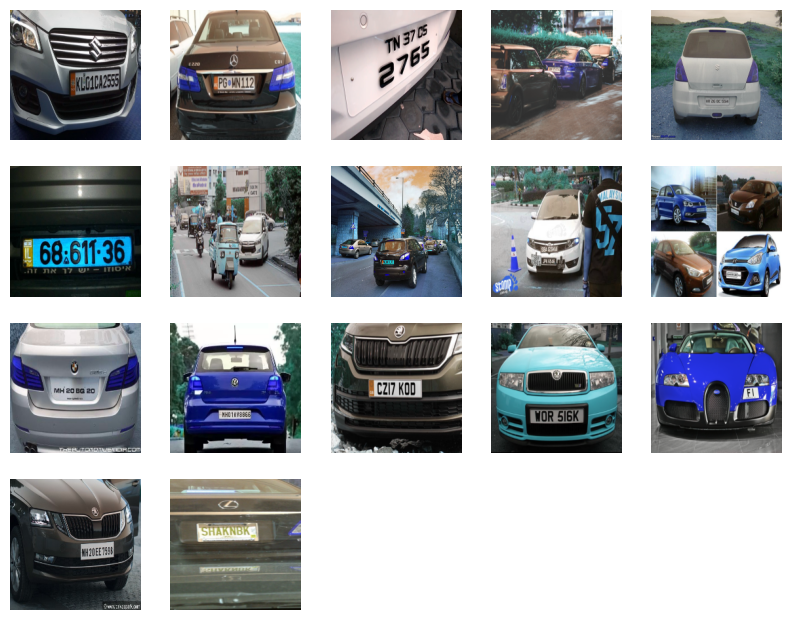

In [89]:
plt.figure(figsize=(10,20))
for i in range(0,17) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    plt.imshow(X[i])

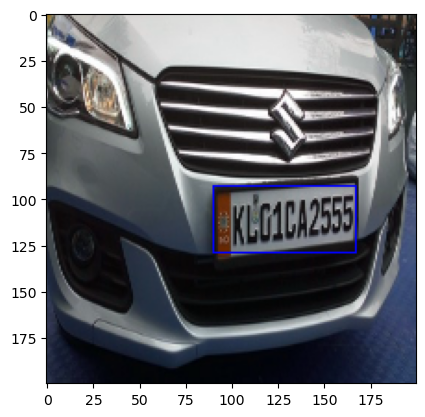

In [90]:
#Mask the rectangle with the licence plate

#Example with the first image of the dataset
image = cv2.rectangle(X[0],(y[0][0],y[0][1]),(y[0][2],y[0][3]),(0, 0, 255))
plt.imshow(image)
plt.show()

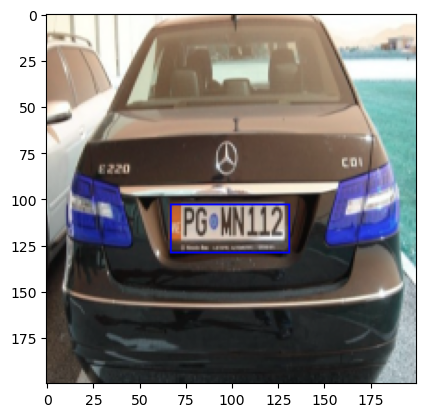

In [91]:
#Example with the second image of the dataset
image = cv2.rectangle(X[1],(y[1][0],y[1][1]),(y[1][2],y[1][3]),(0, 0, 255))
plt.imshow(image)
plt.show()

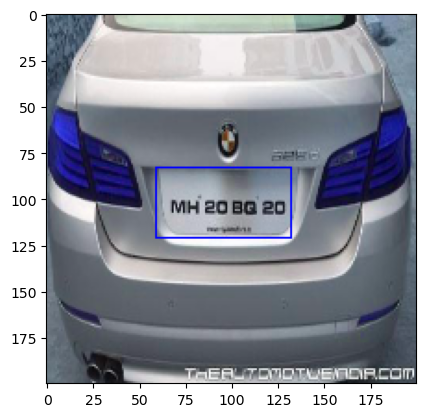

In [92]:
#Example with the 10th image of the dataset
image = cv2.rectangle(X[10],(y[10][0],y[10][1]),(y[10][2],y[10][3]),(0, 0, 255))
plt.imshow(image)
plt.show()

#[151, 131, 70, 4]

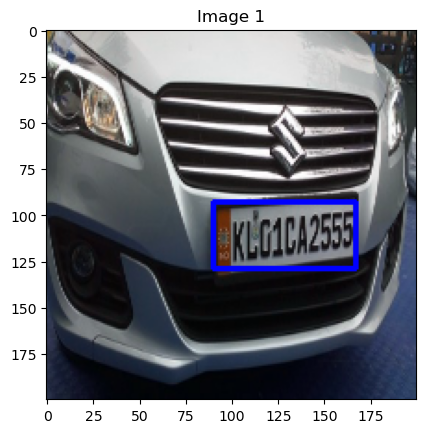

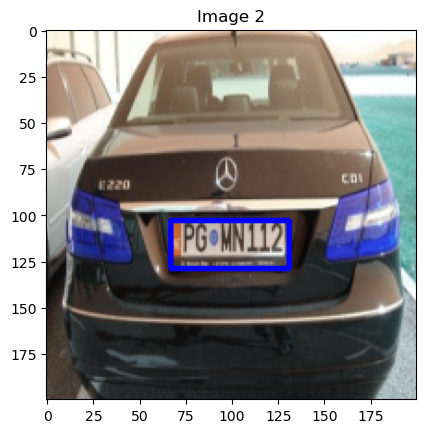

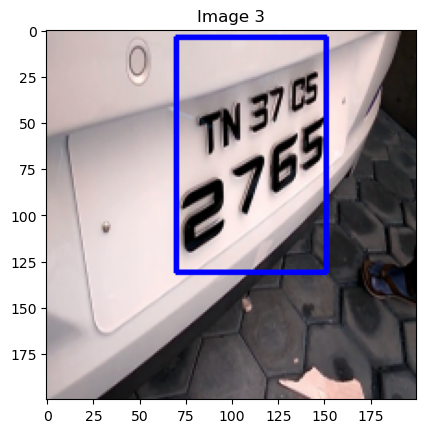

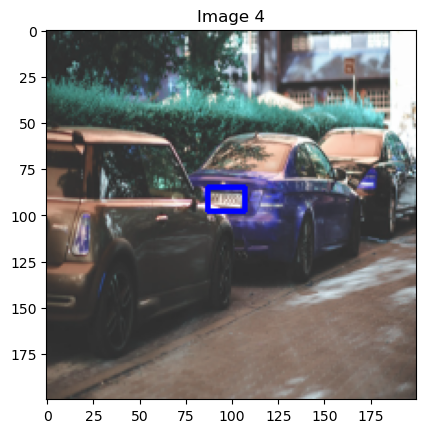

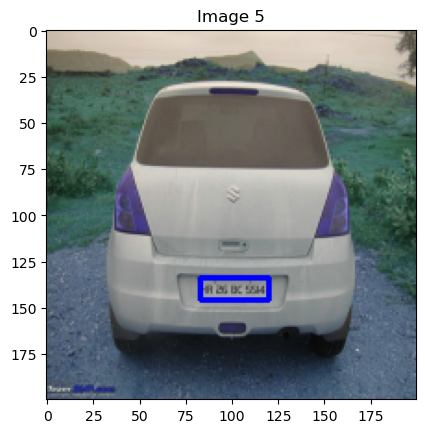

...

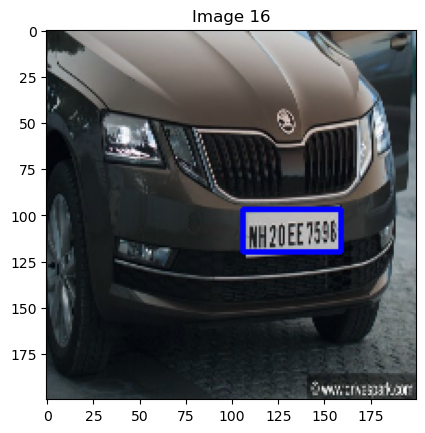

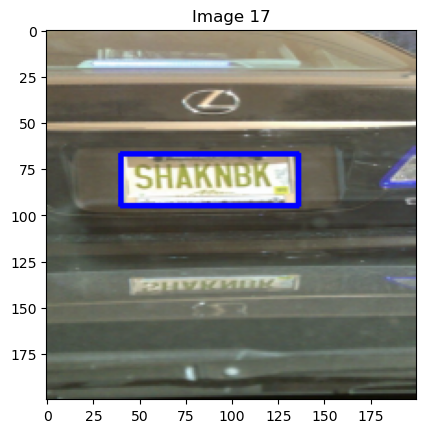

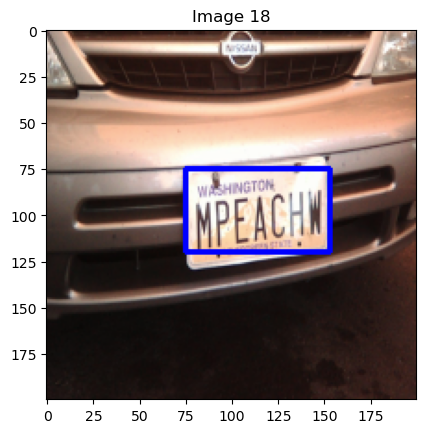

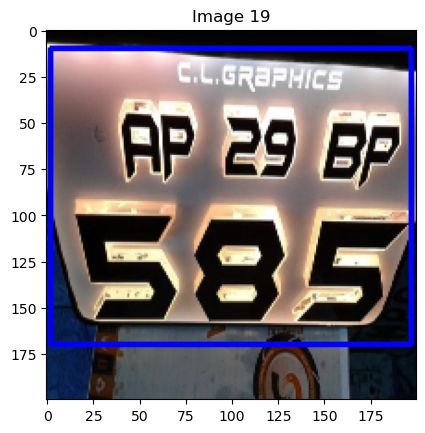

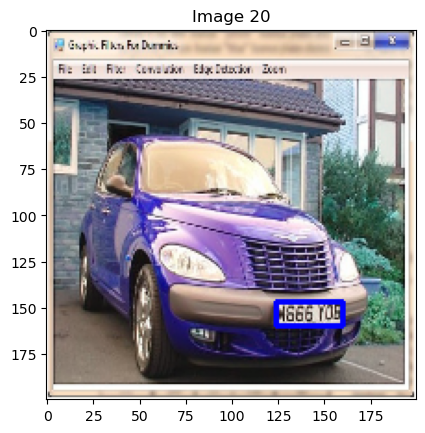

In [93]:
for i in range(20):
    # Create a copy of the image to avoid modifying the original
    image = X[i].copy()
    
    # Draw a red rectangle using the coordinates for the ith image
    cv2.rectangle(image, (y[i][0], y[i][1]), (y[i][2], y[i][3]), (0, 0, 255), 2)
    
    # Display the image with the drawn rectangle
    plt.imshow(image)
    plt.title(f"Image {i+1}")  # Add a title indicating the image number
    plt.show()

In [94]:
# data preparation 

#Transforming in array
X=np.array(X)
y=np.array(y)

In [95]:
X.shape

(481, 200, 200, 3)

In [96]:
# Renormalisation
X = X / 255
y = y / 255

In [97]:
X

array([[[[0.55686275, 0.45098039, 0.23529412],
         [0.63529412, 0.49803922, 0.18431373],
         [0.67843137, 0.57647059, 0.35294118],
         ...,
         [0.14901961, 0.15294118, 0.14901961],
         [0.17254902, 0.16862745, 0.16470588],
         [0.14509804, 0.14117647, 0.13333333]],

        [[0.51764706, 0.43137255, 0.22745098],
         [0.60784314, 0.4745098 , 0.16078431],
         [0.55294118, 0.45882353, 0.25490196],
         ...,
         [0.19215686, 0.19607843, 0.19607843],
         [0.18039216, 0.18431373, 0.17254902],
         [0.14117647, 0.14901961, 0.1372549 ]],

        [[0.51764706, 0.44705882, 0.27058824],
         [0.60392157, 0.48235294, 0.17647059],
         [0.56470588, 0.49411765, 0.31372549],
         ...,
         [0.15294118, 0.15294118, 0.15686275],
         [0.19607843, 0.19215686, 0.18039216],
         [0.14117647, 0.14509804, 0.12941176]],

        ...,

        [[0.15294118, 0.18431373, 0.2745098 ],
         [0.15686275, 0.18823529, 0.27843137]

In [98]:
from sklearn.model_selection import train_test_split
X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.2, random_state=42)
X_test, X_val, y_test, y_val = train_test_split(X_temp, y_temp, test_size=0.5, random_state=42)


# X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.1, random_state=42)

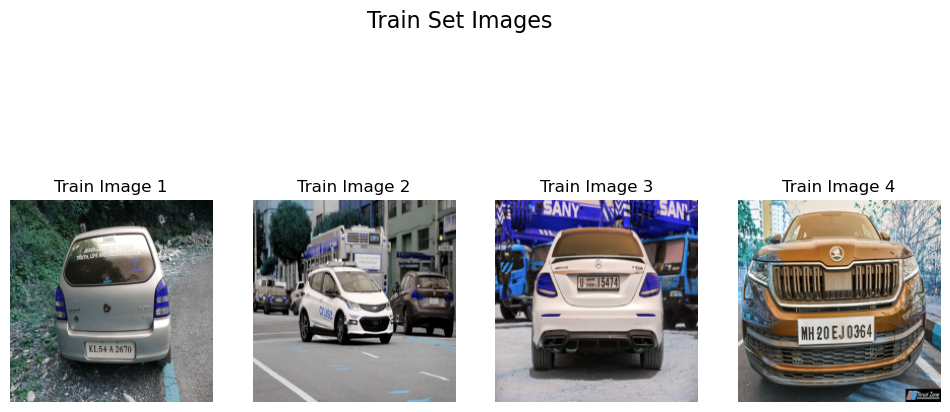

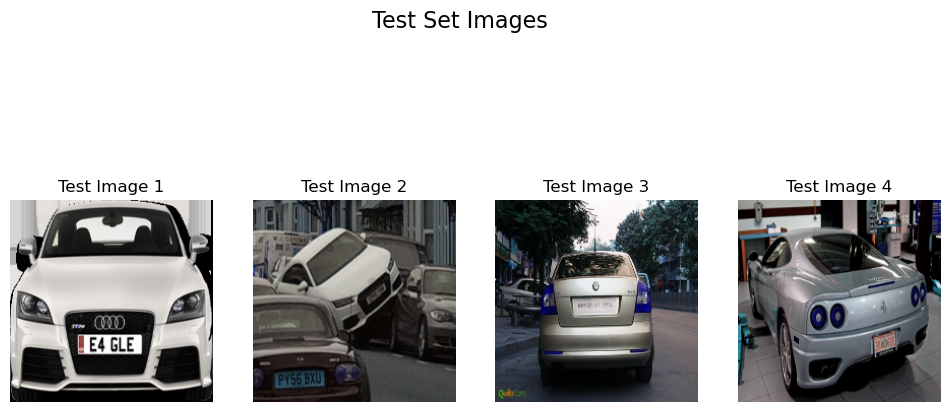

In [99]:
def visualize_test_images(train_data,test_data):
    
    plt.figure(figsize=(12, 6))
    plt.suptitle('Train Set Images', fontsize=16)

    num_images = min(4, len(train_data))  # Display only the first 4 images 

    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(train_data[i], cmap='gray')  
        plt.title(f'Train Image {i + 1}')
        plt.axis('off')
        
    
    plt.figure(figsize=(12, 6))
    plt.suptitle('Test Set Images', fontsize=16)

    num_images = min(4, len(test_data))  

    for i in range(num_images):
        plt.subplot(1, num_images, i + 1)
        plt.imshow(test_data[i], cmap='gray')
        plt.title(f'Test Image {i + 1}')
        plt.axis('off')

    plt.show()
visualize_test_images(X_train,X_test)    

## VGG19

In [100]:
from keras.models import Sequential
from keras.layers import Dense, Flatten, Dropout, BatchNormalization

from keras.applications.vgg19 import VGG19

from tensorflow.keras.optimizers import Adam
from keras.regularizers import l2
from keras.callbacks import LearningRateScheduler

In [103]:
model = Sequential()
model.add(VGG19(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))

model.add(Flatten())
model.add(BatchNormalization())
model.add(Dense(128, activation="relu"))
model.add(Dropout(0.4))
model.add(Dense(128, activation="relu"))

model.add(Dense(64, activation="relu"))
model.add(BatchNormalization())
model.add(Dense(4, activation="sigmoid"))

model.layers[0].trainable = False

model.summary()

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg19 (Functional)          (None, 6, 6, 512)         20024384  
                                                                 
 flatten_4 (Flatten)         (None, 18432)             0         
                                                                 
 batch_normalization_8 (Bat  (None, 18432)             73728     
 chNormalization)                                                
                                                                 
 dense_16 (Dense)            (None, 128)               2359424   
                                                                 
 dropout_4 (Dropout)         (None, 128)               0         
                                                                 
 dense_17 (Dense)            (None, 128)               16512     
                                                      

In [104]:
# def lr_schedule(epoch):
#     if epoch < 10:
#         return 0.002
#     elif epoch < 20:
#         return 0.001
#     else:
#         return 0.0005


In [105]:
optimizer = Adam(learning_rate=0.001)
model.compile(loss='mean_squared_error', optimizer=optimizer, metrics=['accuracy'])

history = model.fit(X_train, y_train, validation_data=(X_test, y_test), epochs=50, batch_size=16, verbose=1)

Epoch 1/50


2023-12-12 23:08:11.410356: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:961] model_pruner failed: INVALID_ARGUMENT: Graph does not contain terminal node Adam/AssignAddVariableOp.


24/24 [==============================] - 5s 181ms/step - loss: 0.0560 - accuracy: 0.2552 - val_loss: 0.0473 - val_accuracy: 0.1250
Epoch 2/50
24/24 [==============================] - 4s 172ms/step - loss: 0.0237 - accuracy: 0.4453 - val_loss: 0.0238 - val_accuracy: 0.1042
Epoch 3/50
24/24 [==============================] - 4s 178ms/step - loss: 0.0155 - accuracy: 0.5000 - val_loss: 0.0156 - val_accuracy: 0.2708
Epoch 4/50
24/24 [==============================] - 4s 181ms/step - loss: 0.0115 - accuracy: 0.6276 - val_loss: 0.0136 - val_accuracy: 0.4792
Epoch 5/50
24/24 [==============================] - 4s 184ms/step - loss: 0.0101 - accuracy: 0.6615 - val_loss: 0.0131 - val_accuracy: 0.6458
Epoch 6/50
24/24 [==============================] - 4s 177ms/step - loss: 0.0092 - accuracy: 0.6771 - val_loss: 0.0127 - val_accuracy: 0.6667
Epoch 7/50
24/24 [==============================] - 4s 173ms/step - loss: 0.0087 - accuracy: 0.6823 - val_loss: 0.0128 - val_accuracy: 0.6667
Epoch 8/50
24/24 

In [106]:
# Test
scores = model.evaluate(X_test, y_test, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

scores = model.evaluate(X_train, y_train, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

Score : 75.00%
Score : 91.15%


In [107]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()

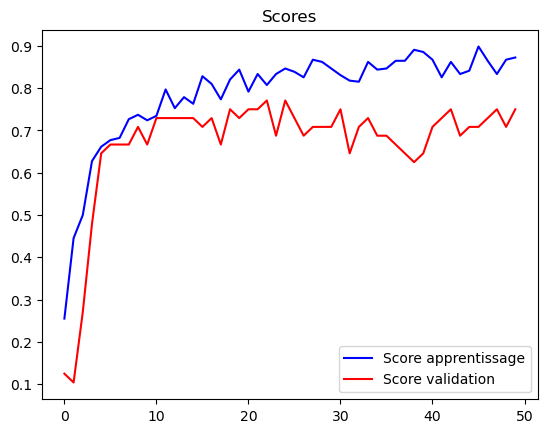

In [108]:
plot_scores(history)

In [109]:
y_cnn = model.predict(X_test)

2/2 [==============================] - 1s 392ms/step


In [110]:
y_cnn.shape

(48, 4)

In [111]:
y_cnn 

array([[0.49095842, 0.5487967 , 0.25683847, 0.42218158],
       [0.35928652, 0.6001727 , 0.24178618, 0.5172222 ],
       [0.4425699 , 0.51699114, 0.34047297, 0.4497151 ],
       [0.43970272, 0.6737379 , 0.42735258, 0.60761833],
       [0.27297565, 0.57333267, 0.16561344, 0.478536  ],
       [0.49823067, 0.48792037, 0.27219117, 0.33713257],
       [0.4700582 , 0.49826097, 0.30737647, 0.38850984],
       [0.61427253, 0.76132774, 0.5210297 , 0.6763862 ],
       [0.30620638, 0.539426  , 0.19359608, 0.47150713],
       [0.47467235, 0.4698656 , 0.28390586, 0.3859865 ],
       [0.4367961 , 0.4634842 , 0.24118641, 0.343649  ],
       [0.46587756, 0.5395585 , 0.29250526, 0.4507907 ],
       [0.45951298, 0.42538792, 0.21469663, 0.29379195],
       [0.48961517, 0.6003575 , 0.33619633, 0.52258396],
       [0.2797531 , 0.5703438 , 0.18859516, 0.49737433],
       [0.48627222, 0.5977927 , 0.3182247 , 0.5034867 ],
       [0.55401456, 0.4959674 , 0.21817729, 0.34066242],
       [0.5130213 , 0.61710405,

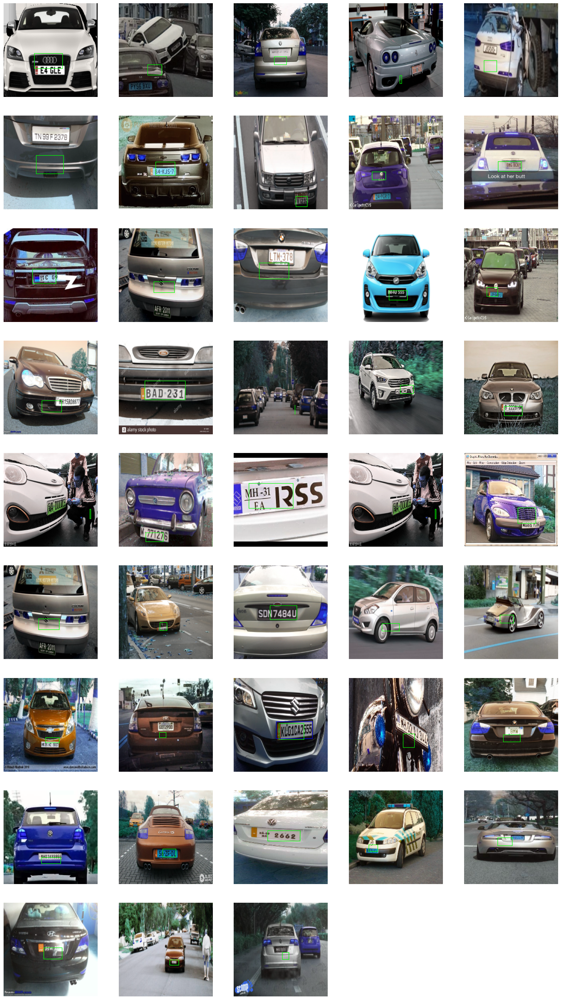

In [112]:
plt.figure(figsize=(20,40))
for i in range(0,43) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i].copy(),(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))
    plt.imshow(image)

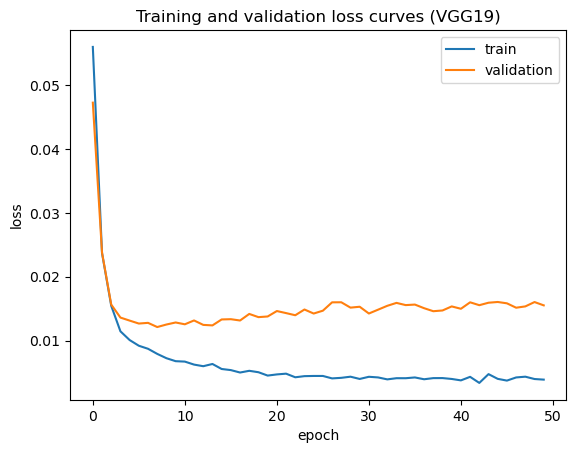

In [113]:
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Training and validation loss curves (VGG19)')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper right')
plt.show()

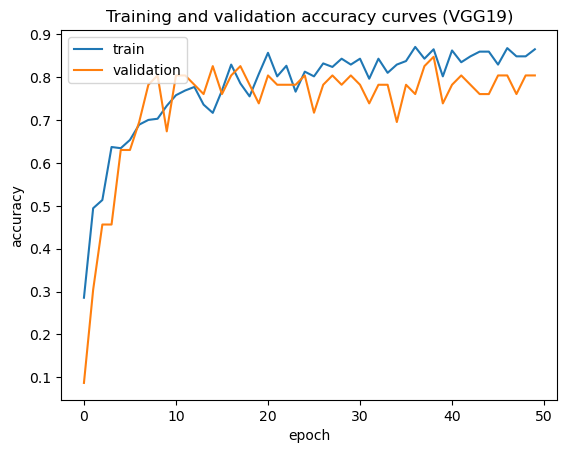

In [35]:
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Training and validation accuracy curves (VGG19)')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['train', 'validation'], loc='upper left')
plt.show()

In [36]:
test_loss, test_accuracy = model.evaluate(X_test, y_test,steps=int(100))
y_cnn = model.predict(X_test)

print("")
print(f"Loss : {test_loss * 100}%")
print(f"Accuracy : {test_accuracy * 100}%")

 46/100 [============>.................] - ETA: 0s - loss: 0.0789 - accuracy: 0.7826WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 100 batches). You may need to use the repeat() function when building your dataset.


2023-12-12 22:44:45.272877: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 2554015122292462169
2023-12-12 22:44:45.272888: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 8314138042480000839
2023-12-12 22:44:45.272892: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 2756675337075141112
2023-12-12 22:44:45.273763: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 5093472124282453394
2023-12-12 22:44:45.273772: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 13247141131494819378


2/2 [==============================] - 0s 395ms/step

Loss : 7.892050594091415%
Accuracy : 78.2608687877655%


In [36]:
from keras.models import save_model, load_model
model.save("model 79 85.h5")

/Users/kartikrathi/anaconda3/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [37]:
def get_iou(ground_truth, pred):
    # coordinates of the area of intersection.
    ix1 = np.maximum(ground_truth[0], pred[0])
    iy1 = np.maximum(ground_truth[1], pred[1])
    ix2 = np.minimum(ground_truth[2], pred[2])
    iy2 = np.minimum(ground_truth[3], pred[3])
     
    # Intersection height and width.
    i_height = np.maximum(iy2 - iy1 + 1, np.array(0.))
    i_width = np.maximum(ix2 - ix1 + 1, np.array(0.))
     
    area_of_intersection = i_height * i_width
     
    # Ground Truth dimensions.
    gt_height = ground_truth[3] - ground_truth[1] + 1
    gt_width = ground_truth[2] - ground_truth[0] + 1
     
    # Prediction dimensions.
    pd_height = pred[3] - pred[1] + 1
    pd_width = pred[2] - pred[0] + 1
     
    area_of_union = gt_height * gt_width + pd_height * pd_width - area_of_intersection
     
    iou = area_of_intersection / area_of_union
     
    return iou

In [38]:
print(y_cnn[3]*255)
print(y_test[3]*255)

[1.5872426e+01 8.8198547e+01 4.5019332e-02 2.2797830e+00]
[127. 127.  95. 109.]


In [244]:
ground_truth_bbox = np.array([108, 141,  88, 123.], dtype=np.float32)
 
prediction_bbox = np.array([105.16521, 139.48004,  82.23282, 122.32729], dtype=np.float32)

In [245]:
iou = get_iou(ground_truth_bbox, prediction_bbox)
print('IOU: ', iou)

IOU:  0.0


## VGG16

In [114]:
from keras.applications.vgg16 import VGG16

model = Sequential()
model.add(VGG16(weights="imagenet", include_top=False, input_shape=(IMAGE_SIZE, IMAGE_SIZE, 3)))

model.add(Flatten())
model.add(BatchNormalization())
model.add(Dense(128, activation="relu"))
model.add(Dropout(0.4))
model.add(Dense(128, activation="relu"))
model.add(Dense(64, activation="relu"))
model.add(BatchNormalization())
model.add(Dense(4, activation="sigmoid"))

model.layers[0].trainable = False

model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 vgg16 (Functional)          (None, 6, 6, 512)         14714688  
                                                                 
 flatten_5 (Flatten)         (None, 18432)             0         
                                                                 
 batch_normalization_10 (Ba  (None, 18432)             73728     
 tchNormalization)                                               
                                                                 
 dense_20 (Dense)            (None, 128)               2359424   
                                                                 
 dropout_5 (Dropout)         (None, 128)               0         
                                                                 
 dense_21 (Dense)            (None, 128)               16512     
                                                      

In [115]:
optimizer = Adam(learning_rate=0.001)
model.compile(loss='mean_squared_error', optimizer='adam', metrics=['accuracy'])

history = model.fit(X_train, y_train, validation_data=(X_val, y_val), epochs=50, batch_size=16, verbose=1)

Epoch 1/50
24/24 [==============================] - 4s 153ms/step - loss: 0.0606 - accuracy: 0.3307 - val_loss: 0.0677 - val_accuracy: 0.0816
Epoch 2/50
24/24 [==============================] - 3s 135ms/step - loss: 0.0261 - accuracy: 0.4167 - val_loss: 0.0172 - val_accuracy: 0.1633
Epoch 3/50
24/24 [==============================] - 3s 136ms/step - loss: 0.0164 - accuracy: 0.4635 - val_loss: 0.0124 - val_accuracy: 0.4490
Epoch 4/50
24/24 [==============================] - 3s 145ms/step - loss: 0.0125 - accuracy: 0.5938 - val_loss: 0.0111 - val_accuracy: 0.5714
Epoch 5/50
24/24 [==============================] - 3s 144ms/step - loss: 0.0107 - accuracy: 0.5781 - val_loss: 0.0095 - val_accuracy: 0.7143
Epoch 6/50
24/24 [==============================] - 3s 146ms/step - loss: 0.0098 - accuracy: 0.6432 - val_loss: 0.0096 - val_accuracy: 0.6531
Epoch 7/50
24/24 [==============================] - 3s 144ms/step - loss: 0.0082 - accuracy: 0.6875 - val_loss: 0.0091 - val_accuracy: 0.6939
Epoch 

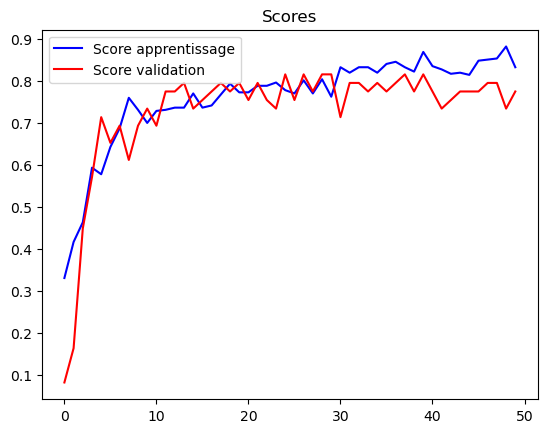

In [116]:
def plot_scores(train) :
    accuracy = train.history['accuracy']
    val_accuracy = train.history['val_accuracy']
    epochs = range(len(accuracy))
    plt.plot(epochs, accuracy, 'b', label='Score apprentissage')
    plt.plot(epochs, val_accuracy, 'r', label='Score validation')
    plt.title('Scores')
    plt.legend()
    plt.show()
plot_scores(history)    

In [117]:
y_cnn = model.predict(X_test)

print(y_test[1]*255)
print(y_cnn[1]*255)

2/2 [==============================] - 2s 2s/step
[ 73. 186.  19. 168.]
[104.66741  145.46495   62.571495 127.95028 ]


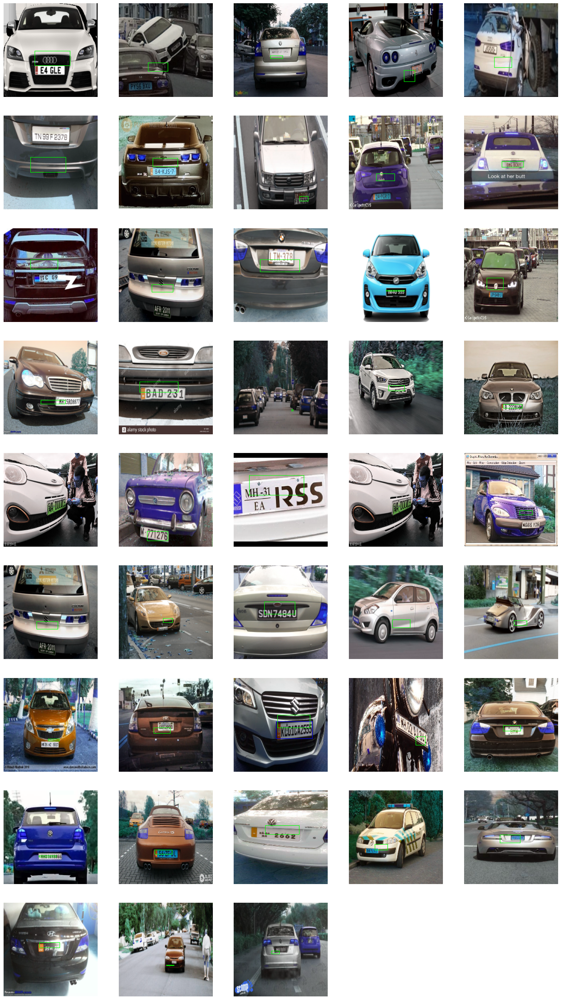

In [118]:
plt.figure(figsize=(20,40))
for i in range(0,43) :
    plt.subplot(10,5,i+1)
    plt.axis('off')
    ny = y_cnn[i]*255
    image = cv2.rectangle(X_test[i].copy(),(int(ny[0]),int(ny[1])),(int(ny[2]),int(ny[3])),(0, 255, 0))
    plt.imshow(image)

In [133]:
# Test
scores = model.evaluate(X_test, y_test, verbose=0)
print("Score : %.2f%%" % (scores[1]*100))

Score : 83.33%


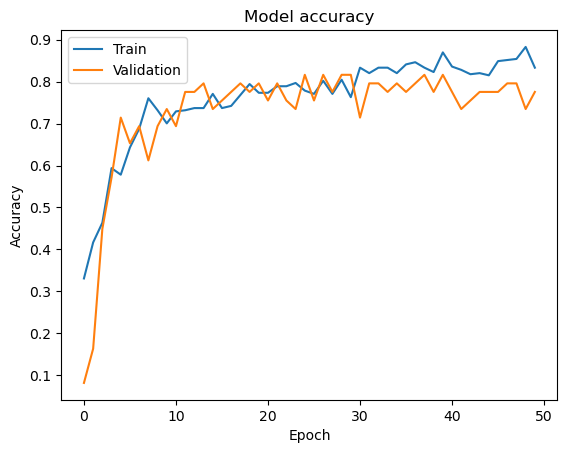

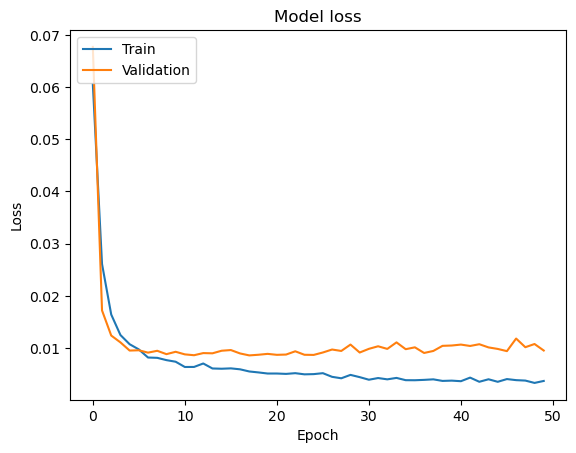

Training Loss: 0.0037, Training Accuracy: 0.8333
Validation Loss: 0.0095, Validation Accuracy: 0.7755


In [134]:
def plot_training_history(history):
    # Plot training & validation accuracy values
    plt.plot(history.history['accuracy'])
    plt.plot(history.history['val_accuracy'])
    plt.title('Model accuracy')
    plt.xlabel('Epoch')
    plt.ylabel('Accuracy')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()

    # Plot training & validation loss values
    plt.plot(history.history['loss'])
    plt.plot(history.history['val_loss'])
    plt.title('Model loss')
    plt.xlabel('Epoch')
    plt.ylabel('Loss')
    plt.legend(['Train', 'Validation'], loc='upper left')
    plt.show()


def print_metrics(history):
    # Extract training and validation metrics
    train_loss = history.history['loss'][-1]
    train_accuracy = history.history['accuracy'][-1]
    val_loss = history.history['val_loss'][-1]
    val_accuracy = history.history['val_accuracy'][-1]

    # Display the metrics
    print(f'Training Loss: {train_loss:.4f}, Training Accuracy: {train_accuracy:.4f}')
    print(f'Validation Loss: {val_loss:.4f}, Validation Accuracy: {val_accuracy:.4f}')

# Example usage:
# Assume 'history' is the history object returned by model.fit
plot_training_history(history)
print_metrics(history)

In [135]:
test_loss, test_accuracy = model.evaluate(X_test, y_test,steps=int(100))
y_cnn = model.predict(X_test)

print("")
print(f"Loss : {test_loss * 100}%")
print(f"Accuracy : {test_accuracy * 100}%")

 47/100 [=============>................] - ETA: 0s - loss: 0.0101 - accuracy: 0.8298WARNING:tensorflow:Your input ran out of data; interrupting training. Make sure that your dataset or generator can generate at least `steps_per_epoch * epochs` batches (in this case, 100 batches). You may need to use the repeat() function when building your dataset.


2023-12-12 23:30:07.384043: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 2330585453406635384
2023-12-12 23:30:07.384064: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 16772390109735254129
2023-12-12 23:30:07.384999: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 11598985573794772157
2023-12-12 23:30:07.385004: I tensorflow/core/framework/local_rendezvous.cc:421] Local rendezvous recv item cancelled. Key hash: 7381705402142068521


2/2 [==============================] - 0s 330ms/step

Loss : 1.060444489121437%
Accuracy : 83.33333134651184%


In [57]:
from keras.models import save_model, load_model
model.save("model 7 dec vgg16.h5")

/Users/kartikrathi/anaconda3/lib/python3.10/site-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


## Load model

In [120]:
from tensorflow import keras

In [121]:
model_path = "/Users/kartikrathi/Documents/ANPR Project/model 7 dec vgg16.h5"
model = keras.models.load_model(model_path)

In [122]:
test_folder_path = "/Users/kartikrathi/Documents/ANPR Project/test"

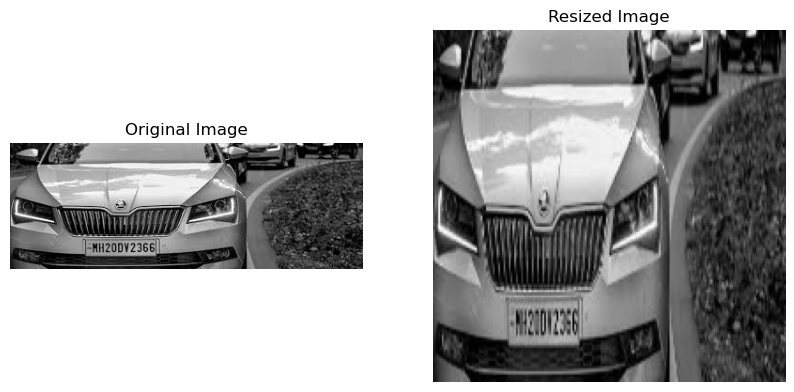

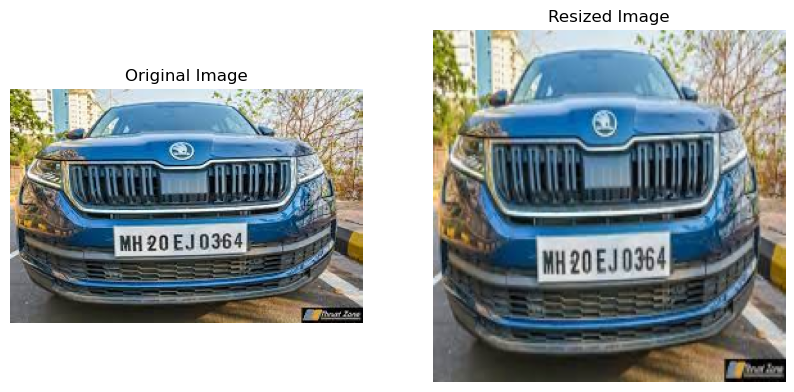

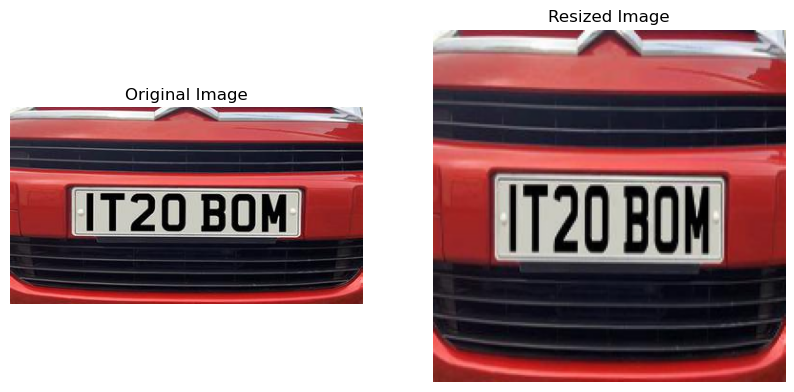

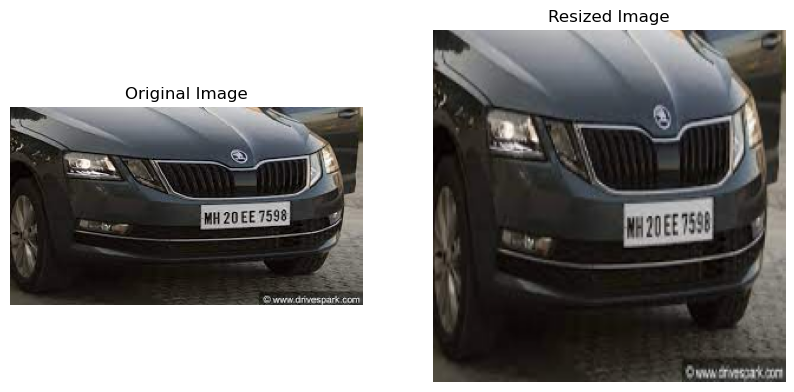

In [123]:
# Desired size for resizing
desired_size = (200, 200)

# List to store resized images as arrays
X_test_new = []

# Loop through each image file
for image_file in os.listdir(test_folder_path):
    if image_file.endswith(('.jpg', '.jpeg', '.png')):
        # Construct the full path to the image
        image_path = os.path.join(test_folder_path, image_file)

        # Load the original image using OpenCV
        img_original = cv2.imread(image_path)

        # Check if the original image is loaded successfully
        if img_original is not None:
            # Resize the image to the desired size
            img_resized = cv2.resize(img_original, desired_size)

            # Convert the resized image to an array
            img_array = np.array(img_resized)

            # Visualize the original and resized images using Matplotlib
            fig, axes = plt.subplots(1, 2, figsize=(10, 5))

            axes[0].imshow(cv2.cvtColor(img_original, cv2.COLOR_BGR2RGB))
            axes[0].set_title('Original Image')
            axes[0].axis('off')

            axes[1].imshow(cv2.cvtColor(img_resized, cv2.COLOR_BGR2RGB))
            axes[1].set_title('Resized Image')
            axes[1].axis('off')

            plt.show()

            # Append the array to X_test
            X_test_new.append(img_array)

            # Optionally, you can save the visualization or annotate further
            # ...

        else:
            print(f"Failed to load image: {image_path}")

# Convert the list of arrays to a NumPy array
X_test_new = np.array(X_test_new)


In [124]:
X_test_new.shape

(4, 200, 200, 3)

In [125]:
X_test_new[1].shape

(200, 200, 3)

In [130]:
# Make sure the input image shape matches the model's expected input shape
expected_shape = model.input_shape[1:]  # (200, 200, 3)

# Resize the image to match the expected input shape
img_resized = cv2.resize(X_test_new[2], (expected_shape[1], expected_shape[0]))

# Normalize the image (if needed)
img_normalized = X_test_new[2] / 255.0  # assuming pixel values are in [0, 255]

# Expand the dimensions to create a batch of size 1
img_expanded = np.expand_dims(img_normalized, axis=0)

# Perform prediction
y_cnn = model.predict(img_expanded)

1/1 [==============================] - 0s 126ms/step


In [131]:
print(y_cnn)
array = (y_cnn*255).astype(int)
print(array)
print(y_test[0]*255)


element_1 = array[0, 0]  # Value at the first row, first column
element_2 = array[0, 1]  # Value at the first row, second column
element_3 = array[0, 2]  # Value at the first row, third column
element_4 = array[0, 3]  # Value at the first row, fourth column

[[0.7072099  0.54289055 0.19033839 0.27672684]]
[[180 138  48  70]]
[130. 152.  66. 132.]


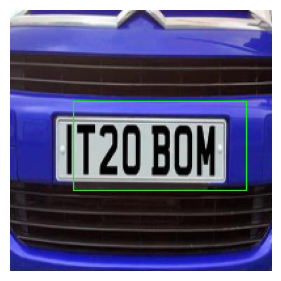

In [132]:
plt.figure(figsize=(20,40))
plt.subplot(10,5,i+1)
plt.axis('off')
image = cv2.rectangle(X_test_new[2].copy(),(element_1 ,element_2),(element_3,element_4),(0, 255, 0))
plt.imshow(image) 

## Calculate IOU

In [55]:
import numpy as np

def calculate_iou(box1, box2):
    x_min = max(box1[0], box2[0])
    y_min = max(box1[1], box2[1])
    x_max = min(box1[2], box2[2])
    y_max = min(box1[3], box2[3])

    intersection_area = max(0, x_max - x_min) * max(0, y_max - y_min)

    box1_area = (box1[2] - box1[0]) * (box1[3] - box1[1])
    box2_area = (box2[2] - box2[0]) * (box2[3] - box2[1])

    union_area = box1_area + box2_area - intersection_area

    iou = intersection_area / union_area if union_area > 0 else 0.0

    return iou

# Example usage:
ground_truths = np.array([[1202, 123,  1650,  868]])
predictions = np.array([[1162, 92,  1619, 694]])

iou = calculate_iou(ground_truths[0], predictions[0])
print(f"IoU: {iou}")


IoU: 0.6422011667705054


In [52]:
y_test[1]

array([0.47843137, 0.44705882, 0.29019608, 0.38431373])

In [ ]:
[122, 114,  74,  98]
[126, 107,  73,  82]